## Image Segmentation

In [ ]:
! wget "http://drive.google.com/uc?export=view&id=1EF4ke1LBRyYM0tfbgiV7c0LPogAs7wz0" -O dog.jpg
! wget "http://drive.google.com/uc?export=view&id=106iRabptomx9nfWbwjo1xYQHhX31QuGg" -O beatles.jpg

--2022-11-15 07:20:31--  http://drive.google.com/uc?export=view&id=1EF4ke1LBRyYM0tfbgiV7c0LPogAs7wz0
Resolving drive.google.com (drive.google.com)... 108.177.126.100, 108.177.126.138, 108.177.126.139, ...
Connecting to drive.google.com (drive.google.com)|108.177.126.100|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://drive.google.com/uc?export=view&id=1EF4ke1LBRyYM0tfbgiV7c0LPogAs7wz0 [following]
--2022-11-15 07:20:32--  https://drive.google.com/uc?export=view&id=1EF4ke1LBRyYM0tfbgiV7c0LPogAs7wz0
Connecting to drive.google.com (drive.google.com)|108.177.126.100|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-00-04-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/go8h9g9keu0m3mpfq4eo7hjtu2fhmile/1668496800000/00197501137516660733/*/1EF4ke1LBRyYM0tfbgiV7c0LPogAs7wz0?e=view&uuid=b158bf39-4472-4fca-b3f9-1d4396b50f7f [following]
--2022-11-15 07:20:32--  https://doc-00-04

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from IPython.display import clear_output
plt.rcParams["figure.figsize"] = (32, 60) # (w, h)

import numpy as np
import time, cv2, math
from typing import AnyStr, Any, Callable


# Helper functions
def read_image(filename: str, grayscale: bool = False, fx: float = 1.0, fy: float = 1.0):
    if grayscale:
      img_result = cv2.imread(filename, cv2.IMREAD_GRAYSCALE)
    else:
      imgbgr = cv2.imread(filename, cv2.IMREAD_COLOR)
      # convert to rgb
      img_result = cv2.cvtColor(imgbgr, cv2.COLOR_BGR2RGB)
    # resize
    if fx != 1.0 and fy != 1.0:
      img_result = cv2.resize(img_result, None, fx=fx, fy=fy, interpolation = cv2.INTER_CUBIC)
    return img_result


def show_in_row(list_of_images: list, titles: list = None, disable_ticks: bool = False):
  if type(list_of_images) != list:
    list_of_images = [list_of_images]
  count = len(list_of_images)
  for idx in range(count):
    subplot = plt.subplot(1, count, idx+1)
    if titles is not None:
      subplot.set_title(titles[idx])

    img = list_of_images[idx]
    cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
    subplot.imshow(img, cmap=cmap)
    if disable_ticks:
      plt.xticks([]), plt.yticks([])
  plt.show()

def show_in_col(list_of_images: list, titles: list = None, disable_ticks: bool = False):
  if type(list_of_images) != list:
    list_of_images = [list_of_images]
  count = len(list_of_images)
  for idx in range(count):
    subplot = plt.subplot(count, 1, idx+1)
    if titles is not None:
      subplot.set_title(titles[idx])

    img = list_of_images[idx]
    cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
    subplot.imshow(img, cmap=cmap)
    if disable_ticks:
      plt.xticks([]), plt.yticks([])
  plt.show()

## Lab Objectives
Image segmentation with classic approach (SLIC)<br>


## The Algorithm

1) Convert image to LAB colorspace<br>
2) Initalize **K** clusters `[L, A, B, x, y]` in low gradient area<br>
3) For each pixel find closest cluster <br>
4) Move cluster to mean pixel <br>
5) Repeat steps 3 & 4 10 times <br>
6) Connect pixels to clusters by connectivity (?)

----

More information [here](https://jayrambhia.com/blog/superpixels-slic)

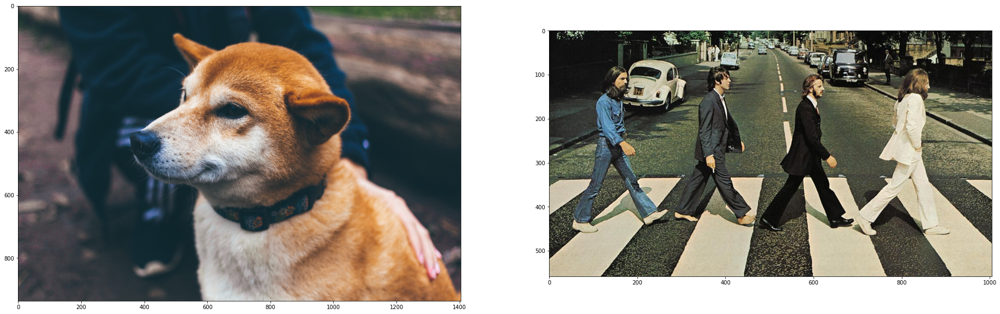

In [ ]:
# check image
orig_img = read_image("dog.jpg", False, 0.25, 0.25)
orig_img2 = read_image("beatles.jpg", False, 1.0, 1.0)
show_in_row([orig_img, orig_img2])

### 1) LAB colorspace

In [ ]:
def to_lab(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2LAB)

# test lab
lab_img = to_lab(orig_img)

L, A, B = cv2.split(lab_img)
show_in_col([lab_img, L, A, B], ["LAB", "L", "A (green - red)", "B (blue - yellow"])

### 2) Initialization

936 1404
Expected: 150 Result: 130


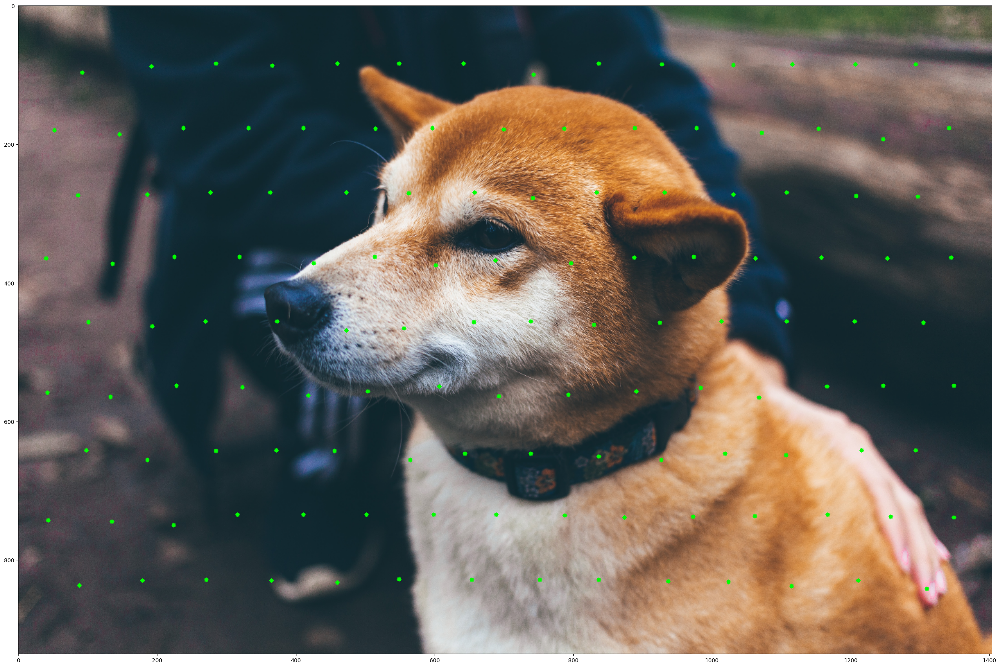

In [ ]:
def find_local_minimum(gray_img: np.array, pos: tuple, check_grid_area: tuple) -> tuple:
    # return pos
    min_pos = pos

    from_y = (min_pos[0] - int(check_grid_area[0] / 2))
    to_y = from_y + check_grid_area[0]
    min_val = gray_img[pos[0], pos[1]]
    from_x = (min_pos[1] - int(check_grid_area[1] / 2))
    to_x = from_x + check_grid_area[1]

    sub_img = gray_img[from_y:to_y, from_x:to_x]

    offset = np.unravel_index(sub_img.argmin(), sub_img.shape)
    minimum = (offset[0] + from_y, offset[1] + from_x)

    return minimum


def slic_init(img: np.array, clusters_count: int, check_grid_area: tuple = None) -> list:
    # initalize clusters in low gradient
    # returns list of clusters [{"pos": (x, y), "color": (color_tuple)}]
    x = cv2.Sobel(img, -1, 1, 0, borderType=cv2.BORDER_REPLICATE)
    y = cv2.Sobel(img, -1, 0, 1, borderType=cv2.BORDER_REPLICATE)
    yx_grad = np.abs(np.sum(x, 2)) + np.abs(np.sum(y, 2))

    step = (img.shape[0] * img.shape[1] / float(clusters_count)) ** 0.5
    step = int(step)
    if check_grid_area is None:
        check_grid_area = (int(step * 0.2), int(step * 0.2))

    clusters = []
    row_idx = 0
    height, width = img.shape[:2]
    print(height, width)
    for r in range(step, int(height - check_grid_area[0]), step):
        offset = step if row_idx % 2 == 0 else step/2
        offset = int(offset)
        row_idx += 1

        for c in range(offset, int(width - check_grid_area[1]), step):
            yx = find_local_minimum(yx_grad, (r, c), check_grid_area)
            color = img[yx[0], yx[1]]
            clusters.append({"pos": yx, "color": color})

    return clusters

def draw_cluster_centers(img, color, clusters):
    for c in clusters:
        pos = c["pos"]
        pos = (int(pos[1]), int(pos[0]))
        cv2.circle(img, pos, 3, color, -1)

n_count = 150
clusters = slic_init(lab_img, n_count)
print("Expected:",n_count, "Result:", len(clusters))

# debug draw
debug_img = orig_img.copy()
draw_cluster_centers(debug_img, (0, 255, 0), clusters)
show_in_row(debug_img)

### 3-4) Connect pixels to clusters, move clusters

In [ ]:
def do_step(lab_img: np.array, clusters: list, m: float = 45) -> list:
    # return list of new clusters

    big_value = 1000000.0
    distances = big_value * np.ones(lab_img.shape[:2])
    clusters_indexes = np.ones(lab_img.shape[:2]) * (-1)

    new_clusters = []
    step = (lab_img.shape[0] * lab_img.shape[1] / float(len(clusters))) ** 0.5
    dist_multiplier = m / step
    max_distance = 2 * step

    for idx, c in enumerate(clusters):
        p = c["pos"]
        from_y = int(max(0, p[0] - max_distance))
        to_y = int(min(lab_img.shape[0], p[0] + max_distance + 1))
        from_x = int(max(0, p[1] - max_distance))
        to_x = int(min(lab_img.shape[1], p[1] + max_distance + 1))

        yy, xx = np.ogrid[from_y : to_y, from_x : to_x]
        pix_dist = ((yy-p[0])**2 + (xx-p[1])**2)**0.5

        color_dist = np.abs(lab_img[from_y:to_y, from_x:to_x] - c["color"])
        color_dist = np.sqrt(np.sum(np.square(color_dist), axis=2))

        sum_dist = ((dist_multiplier * pix_dist)**2 + color_dist**2)**0.5

        indexes = distances[from_y:to_y, from_x:to_x] > sum_dist
        distances[from_y:to_y, from_x:to_x][indexes] = sum_dist[indexes]
        clusters_indexes[from_y:to_y, from_x:to_x][indexes] = idx

    indnp = np.mgrid[0:lab_img.shape[0], 0:lab_img.shape[1]].transpose(1, 2, 0)
    for k in range(len(clusters)):
        idx = (clusters_indexes == k)
        new_color = np.mean(lab_img[idx], axis=0)
        new_pos = np.mean(indnp[idx], axis=0)
        new_clusters.append({'pos': new_pos, 'color': new_color})
    # show_in_col([clusters_indexes==10, lab_img])
    return new_clusters, clusters_indexes

def color_clusters(img, clusters, clusters_indexes):
  draw_image = img.copy()
  for k in range(len(clusters)):
      idx = (clusters_indexes == k)
      draw_image[idx] = clusters[k]['color']
  return cv2.cvtColor(draw_image, cv2.COLOR_LAB2BGR)

test_clusters = clusters.copy()
debug_img = orig_img.copy()
draw_cluster_centers(debug_img, (0, 255, 0), test_clusters)
for i in range(10):
    color = (i*5, 0, 255)
    test_clusters, cluster_indices = do_step(lab_img, test_clusters)
    draw_cluster_centers(debug_img, color, test_clusters)
    print("step", i)
show_in_row([debug_img, color_clusters(orig_img, test_clusters, cluster_indices), cluster_indices])
print("done")

NameError: name 'np' is not defined

##Semantic Segmentation

Semantic Segmentation is an image analysis task in which we classify each pixel in the image into a class. <br/>

Similar to what us humans do all the time by default, when are looking then whatever we are seeing if we think of that as an image
then we know what class each pixel of the image belongs to.

Essentially, Semantic Segmentation is the technique through which we can achieve this in Computers.

So, let's say we have the following image.

![](https://lh3.googleusercontent.com/-ELUnFgFJqUU/XPPXOOmhfMI/AAAAAAAAAP0/2cabsTI9uGUYxM3O3w4EOxjR_iJvEQAvACK8BGAs/s374/index3.png)
<small> Source: Pexels </small>

And then given the above image its semantically segmentated image would be the following

![](https://lh3.googleusercontent.com/-gdUavPeOxdg/XPPXQngAnvI/AAAAAAAAAQA/yoksBterCGQGt-lv3aX4kfyMUDXTar7yACK8BGAs/s374/index4.png)

As you can see, that each pixel in the image is classified to its respective class.

This is in most simple terms what Semantic Segmentation is.

## Applications of Segmentation


The most common use case for the Semantic Segmentation is in:

1. **Autonomous Driving**

  <img src="https://cdn-images-1.medium.com/max/1600/1*JKmS08bllQ8SCajIPyiBBQ.png" width="400"/> <br/>
  <small> Source: CityScapes Dataset </small>
  
  In autonomous driving, the image which comes in from the camera is semantically segmented, thus each pixel in the image is classified
  into a class. This helps the computer understand what is present in the its surroundings and thus helps the car act accordingly.


2. **Facial Segmentation**

  <img src="https://i.ytimg.com/vi/vrvwfFej_r4/maxresdefault.jpg" width="400"/> <br/>
  <small> Source: https://github.com/massimomauro/FASSEG-repository/blob/master/papers/multiclass_face_segmentation_ICIP2015.pdf </small>

  Facial Segmentation is used for segmenting each part of the face into a category, like lips, eyes etc. This technique is used for
  many purposes such as gender estimation, age estimation, facial expression analysis, emotional analysis and more.
  

3. **Indoor Object Segmentation**

  <img src="https://cs.nyu.edu/~silberman/rmrc2014/header_semantic_segmentation.jpg" width="400"/><br/>
  <small> Source: http://buildingparser.stanford.edu/dataset.html </small>

  Guess where is this used? In AR (Augmented Reality) and VR (Virtual Reality). AR applications when required segments the entire indoor area to understand where there
  are chairs, tables, people, wall, and other obstacles and so on.


4. **Geo-Land Sensing**

  <img src="https://ars.els-cdn.com/content/image/1-s2.0-S0924271616305305-fx1_lrg.jpg" width="400"/> <br/>
  <small> Source: https://www.sciencedirect.com/science/article/pii/S0924271616305305 </small>

  Geo Land Sensing is a way of categorizing each pixel in satellite images into a category such that we can track the land cover of each
  area. So, say in some area there is a heavy deforestation taking place then appropriate measures can be taken.


## Using torchvision for Semantic Segmentation

Now before we get started, we need to know about the inputs and outputs of these semantic segmentation models.<br/>
So, let's start!

These models expect a 3-channled image which is normalized with the Imagenet mean and standard deviation, i.e., <br/>
`mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225]`

So, the input is `[Ni x Ci x Hi x Wi]`<br/>
where,
- `Ni` -> the batch size
- `Ci` -> the number of channels (which is 3)
- `Hi` -> the height of the image
- `Wi` -> the width of the image

And the output of the model is `[No x Co x Ho x Wo]`<br/>
where,
- `No` -> is the batch size (same as `Ni`)
- `Co` -> **is the number of classes that the dataset have!**
- `Ho` -> the height of the image (which is the same as `Hi` in almost all cases)
- `Wo` -> the width of the image (which is the same as `Wi` in almost all cases)

Alright! And just one more thing!
The `torchvision` models outputs an `OrderedDict` and not a `torch.Tensor` <br/>
And in `.eval()` mode it just has one key `out` and thus to get the output we need to get the value
stored in that `key`.

The `out` key of this `OrderedDict` is the key that holds the output. <br/>
So, this `out` key's value has the shape of `[No x Co x Ho x Wo]`.

Now! we are ready to play :)

### FCN with Resnet-101 backbone

FCN - Fully Convolutional Netowrks, are among the most early invented Neural Networks for the task of Semantic Segmentation.

Let's load one up!

In [ ]:
from torchvision import models
fcn = models.segmentation.fcn_resnet101(pretrained=True).eval()
# check other models on
# https://pytorch.org/vision/stable/models.html

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=FCN_ResNet101_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=FCN_ResNet101_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fcn_resnet101_coco-7ecb50ca.pth" to /root/.cache/torch/hub/checkpoints/fcn_resnet101_coco-7ecb50ca.pth


  0%|          | 0.00/208M [00:00<?, ?B/s]

And that's it we have a pretrained model of `FCN` (which stands for Fully Convolutional Neural Networks) with a `Resnet101` backbone :)

Now, let's get an image!

2022-11-15 07:21:14 URL:https://static.independent.co.uk/s3fs-public/thumbnails/image/2018/04/10/19/pinyon-jay-bird.jpg [182965/182965] -> "bird.png" [1]


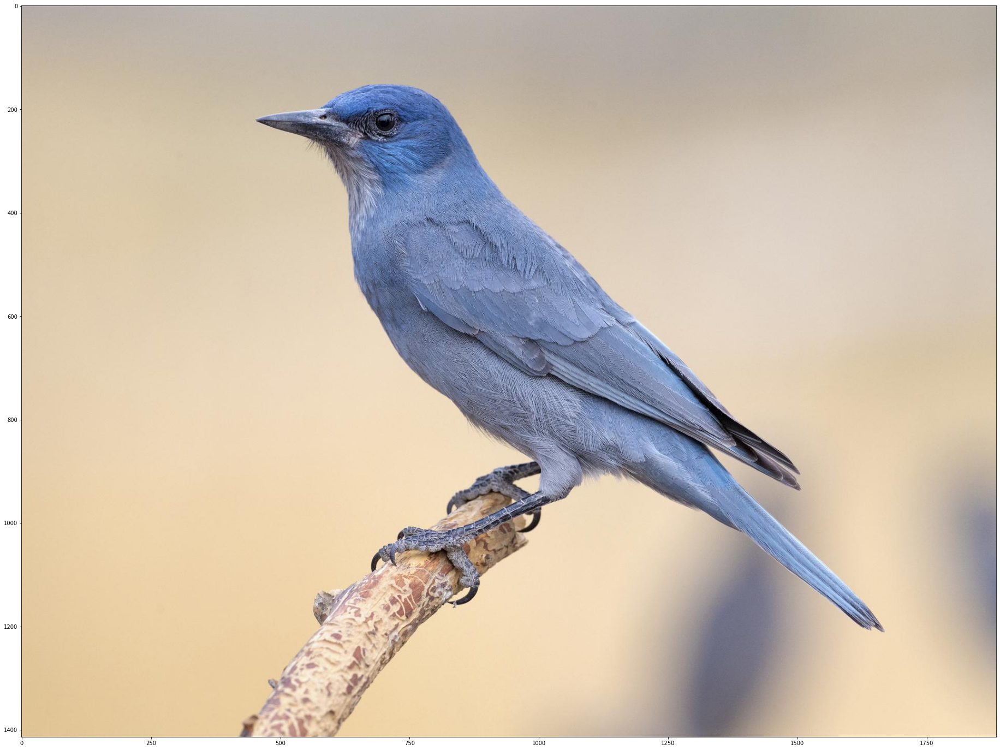

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
import torch

!wget -nv https://static.independent.co.uk/s3fs-public/thumbnails/image/2018/04/10/19/pinyon-jay-bird.jpg -O bird.png
img = Image.open('./bird.png')
plt.imshow(img); plt.show()

Now, that we have the image we need to preprocess it and normalize it! <br/>
So, for the preprocessing steps, we:
- Resize the image to `(256 x 256)`
- CenterCrop it to `(224 x 224)`
- Convert it to Tensor - all the values in the image becomes between `[0, 1]` from `[0, 255]`
- Normalize it with the Imagenet specific values `mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225]`

And lastly, we unsqueeze the image so that it becomes `[1 x C x H x W]` from `[C x H x W]` <br/>
We need a batch dimension while passing it to the models.

In [ ]:
# Apply the transformations needed
import torchvision.transforms as T
trf = T.Compose([T.Resize(256),
                 T.CenterCrop(224),
                 T.ToTensor(),
                 T.Normalize(mean = [0.485, 0.456, 0.406],
                             std = [0.229, 0.224, 0.225])])
inp = trf(img).unsqueeze(0)

Let's see what the above code cell does </br>
`T.Compose` is a function that takes in a `list` in which each element is of `transforms` type and </br>
it returns a object through which we can
pass batches of images and all the required transforms will be applied to the images.

Let's take a look at the transforms applied on the images:
- `T.Resize(256)` : Resizes the image to size `256 x 256`
- `T.CenterCrop(224)` : Center Crops the image to have a resulting size of `224 x 224`
- `T.ToTensor()` : Converts the image to type `torch.Tensor` and have values between `[0, 1]`
- `T.Normalize(mean, std)` : Normalizes the image with the given mean and standard deviation.

Alright! Now that we have the image all preprocessed and ready! Let's pass it through the model and get the `out` key.<br/>
As I said, the output of the model is a `OrderedDict` so, we need to take the `out` key from that to get the output of the model.

In [ ]:
# Pass the input through the net
out = fcn(inp)['out']
print (out.shape)

torch.Size([1, 21, 224, 224])


Alright! So, `out` is the final output of the model. And as we can see, its shape is `[1 x 21 x H x W]` as discussed earlier. So, the model was trained on `21` classes and thus our output have `21` channels!<br/>

Now, what we need to do is make this `21` channeled output into a `2D` image or a `1` channeled image, where each pixel of that image corresponds to a class!

So, the `2D` image, (of shape `[H x W]`) will have each pixel corresponding to a class label, and thus <br/>
for each `(x, y)` in this `2D` image will correspond to a number between `0 - 20` representing a class.

And how do we get there from this `[1 x 21 x H x W]`?<br/>
We take a max index for each pixel position, which represents the class<br/>

In [ ]:
import numpy as np
om = torch.argmax(out.squeeze(), dim=0).detach().cpu().numpy()
print (om.shape)
print (np.unique(om))

(224, 224)
[0 3]


Alright! So, we as we can see now have a `2D` image. Where each pixel corresponds to a class!
The last thing is to take this `2D` image where each pixel corresponds to a class label and convert this<br/>
into a segmentation map where each class label is converted into a `RGB` color and thus helping in easy visualization.

We will use the following function to convert this `2D` image to an `RGB` image wheree each label is mapped to its
corresponding color.

In [ ]:
# Define the helper function
def decode_segmap(image, nc=21):

  label_colors = np.array([(0, 0, 0),  # 0=background
               # 1=aeroplane, 2=bicycle, 3=bird, 4=boat, 5=bottle
               (128, 0, 0), (0, 128, 0), (128, 128, 0), (0, 0, 128), (128, 0, 128),
               # 6=bus, 7=car, 8=cat, 9=chair, 10=cow
               (0, 128, 128), (128, 128, 128), (64, 0, 0), (192, 0, 0), (64, 128, 0),
               # 11=dining table, 12=dog, 13=horse, 14=motorbike, 15=person
               (192, 128, 0), (64, 0, 128), (192, 0, 128), (64, 128, 128), (192, 128, 128),
               # 16=potted plant, 17=sheep, 18=sofa, 19=train, 20=tv/monitor
               (0, 64, 0), (128, 64, 0), (0, 192, 0), (128, 192, 0), (0, 64, 128)])

  r = np.zeros_like(image).astype(np.uint8)
  g = np.zeros_like(image).astype(np.uint8)
  b = np.zeros_like(image).astype(np.uint8)

  for l in range(0, nc):
    idx = image == l
    r[idx] = label_colors[l, 0]
    g[idx] = label_colors[l, 1]
    b[idx] = label_colors[l, 2]

  rgb = np.stack([r, g, b], axis=2)
  return rgb

Let's see what we are doing inside this function!

first `label_colors` stores the colors for each of the clases, according to the index </br>
So, the color for the  first class which is `background` is stored in the `0`th index of the `label_colors` list,
the second class which is `aeroplane` is stored at index `1` of `label_colors`.

Now, we are to create an `RGB` image from the `2D` image passed. So, what we do, is we create empty `2D` matrices for all 3 channels.

So, `r`, `g`, and `b` are arrays which will form the `RGB` channels for the final image. And each are of shape `[H x W]`
(which is same as the shape of `image` passed in)

Now, we loop over each class color we stored in `label_colors`.
And we get the indexes in the image where that particular class label is present. (`idx = image == l`)
And then for each channel, we put its corresponding color to those pixels where that class label is present.

And finally we stack the 3 seperate channels to form a `RGB` image.

Okay! Now, let's use this function to see the final segmented output!

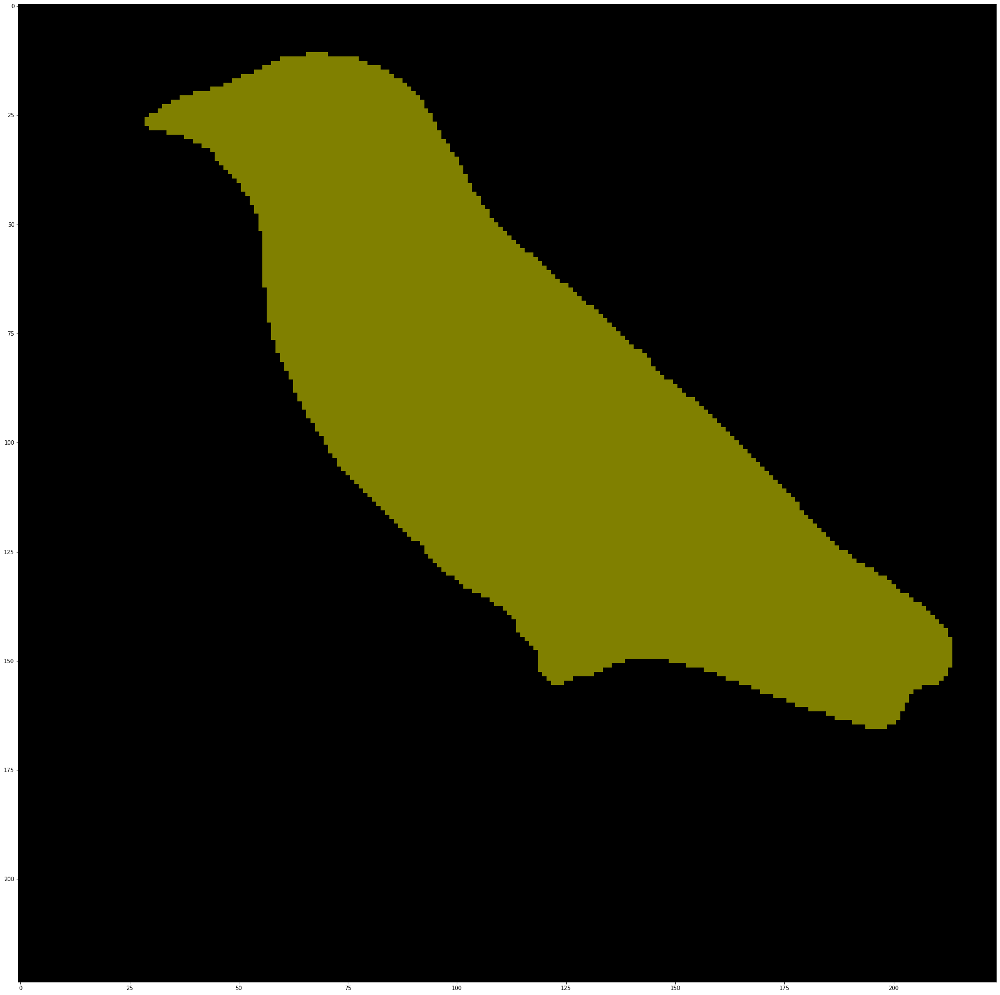

In [ ]:
rgb = decode_segmap(om)
plt.imshow(rgb); plt.show()



**Do note** that the image after segmentation is smaller than the original image as in the preprocessing step the image is resized and cropped.

Next, let's move all this under one function and play with a few more images!

In [ ]:
def segment(net, path, show_orig=True, dev='cuda'):
  img = Image.open(path)
  if show_orig: plt.imshow(img); plt.axis('off'); plt.show()
  # Comment the Resize and CenterCrop for better inference results
  trf = T.Compose([T.Resize(640),
                   #T.CenterCrop(224),
                   T.ToTensor(),
                   T.Normalize(mean = [0.485, 0.456, 0.406],
                               std = [0.229, 0.224, 0.225])])
  inp = trf(img).unsqueeze(0).to(dev)
  out = net.to(dev)(inp)['out']
  om = torch.argmax(out.squeeze(), dim=0).detach().cpu().numpy()
  rgb = decode_segmap(om)
  plt.imshow(rgb); plt.axis('off'); plt.show()

Let's get a new image!

2022-11-15 07:21:18 URL:https://www.learnopencv.com/wp-content/uploads/2021/01/horse-segmentation.jpeg [128686/128686] -> "horse.png" [1]


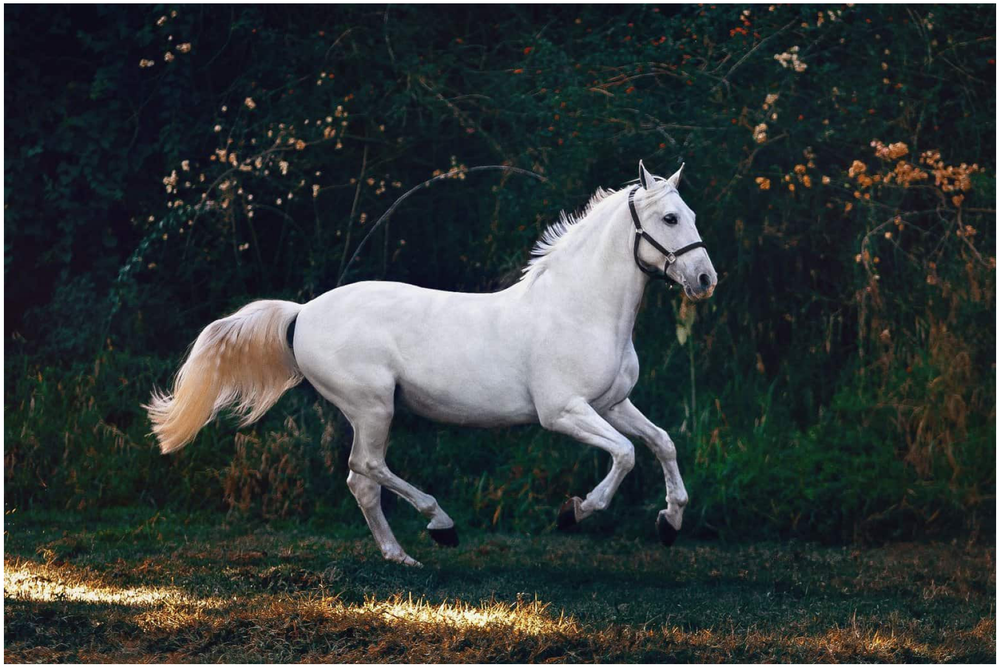

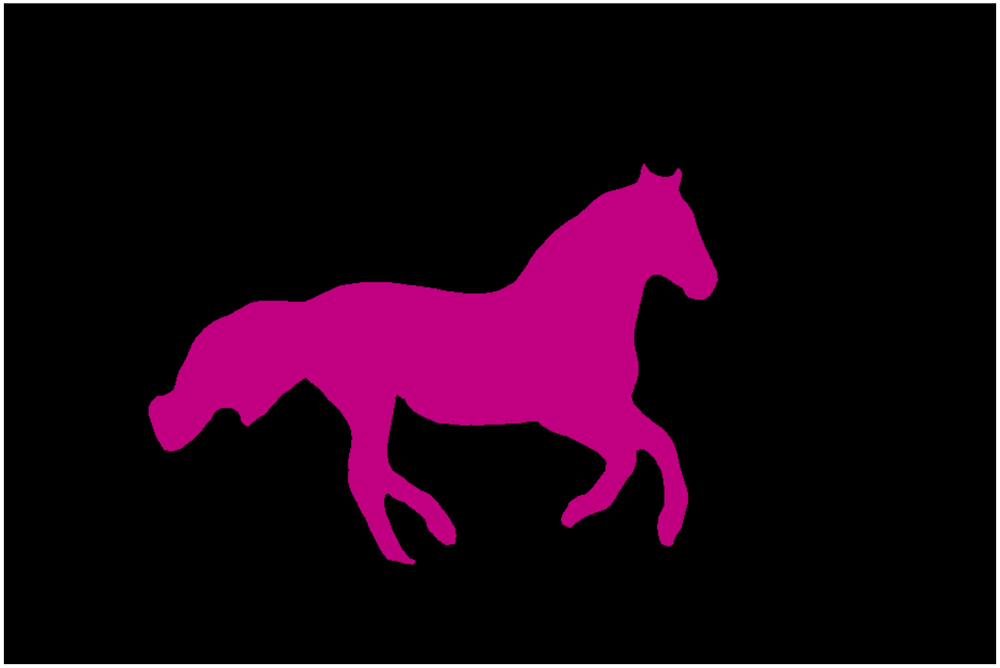

In [ ]:
!wget -nv https://www.learnopencv.com/wp-content/uploads/2021/01/horse-segmentation.jpeg -O horse.png
segment(fcn, './horse.png')

### DeepLabv3

DeepLab is a state-of-the-art semantic segmentation model designed and open-sourced by Google.


check [this](
https://towardsdatascience.com/the-evolution-of-deeplab-for-semantic-segmentation-95082b025571) and [this](https://colab.research.google.com/github/tensorflow/models/blob/master/research/deeplab/deeplab_demo.ipynb#scrollTo=edGukUHXyymr) for more details

In [ ]:
dlab = models.segmentation.deeplabv3_resnet101(pretrained=1).eval()

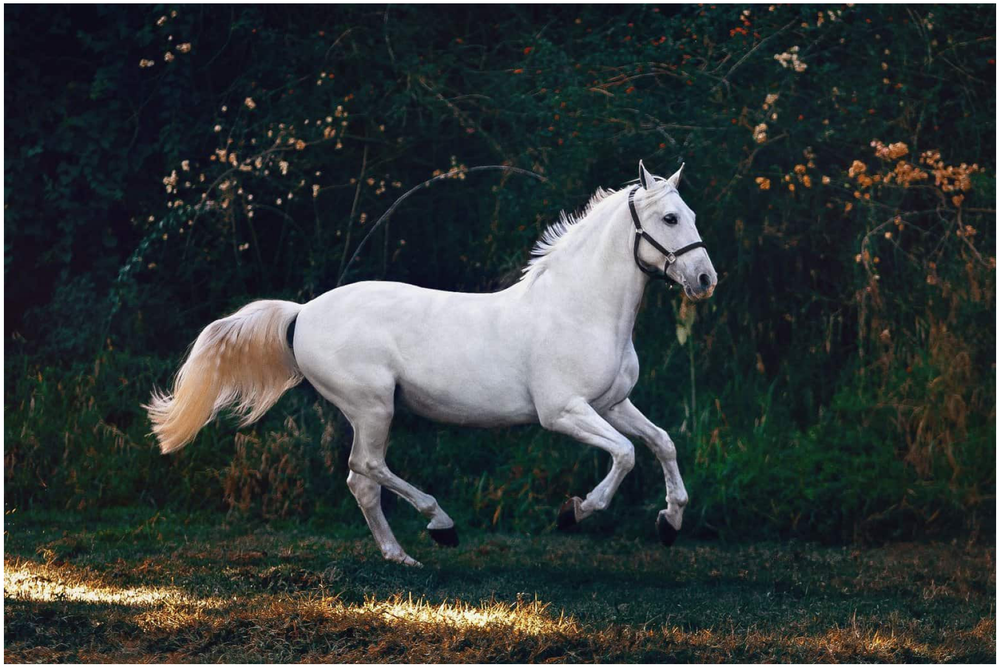

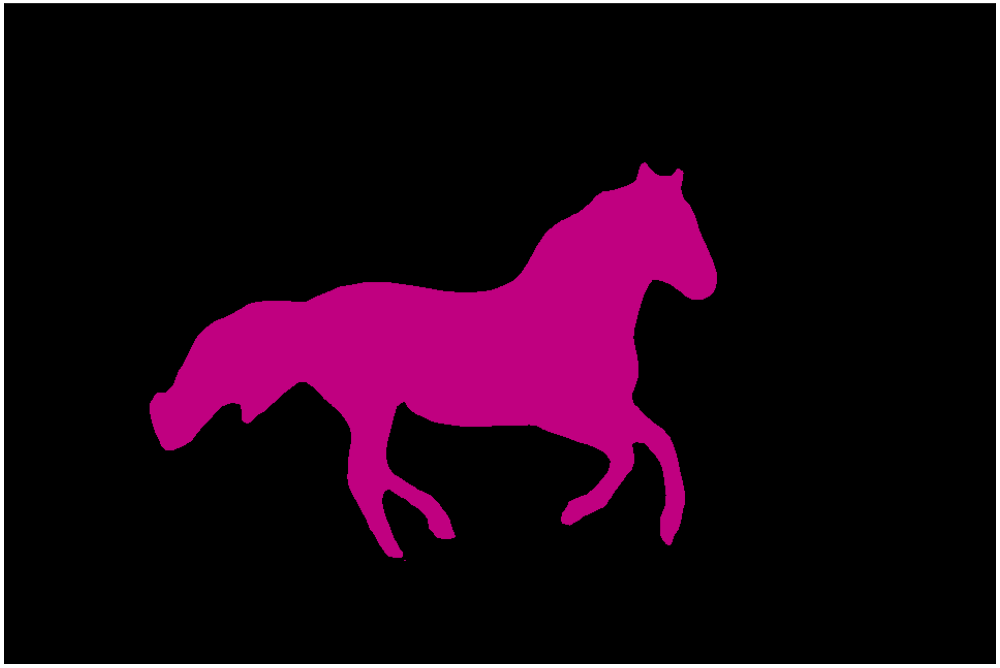

In [ ]:
segment(dlab, './horse.png')

2022-11-15 07:22:26 URL:https://www.learnopencv.com/wp-content/uploads/2021/01/person-segmentation.jpeg [95431/95431] -> "person.png" [1]


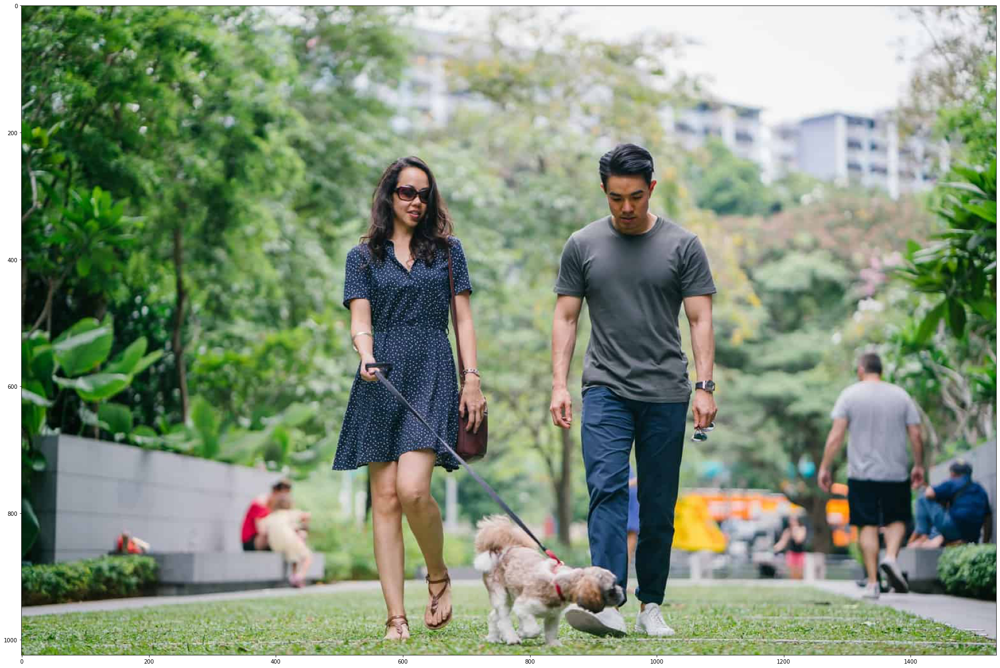

Segmenatation Image on FCN


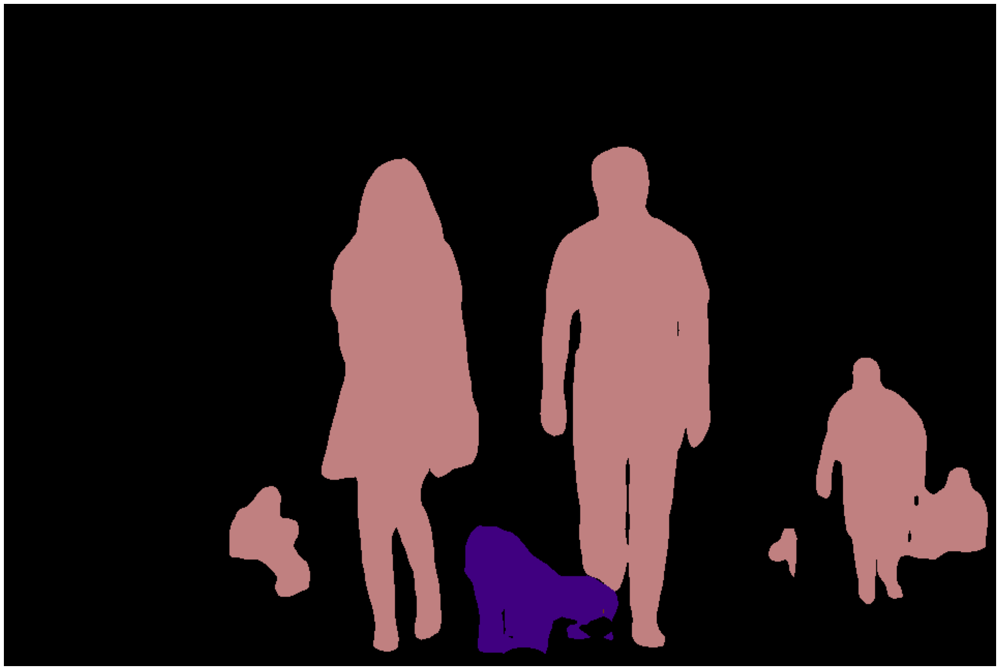

Segmenatation Image on DeepLabv3


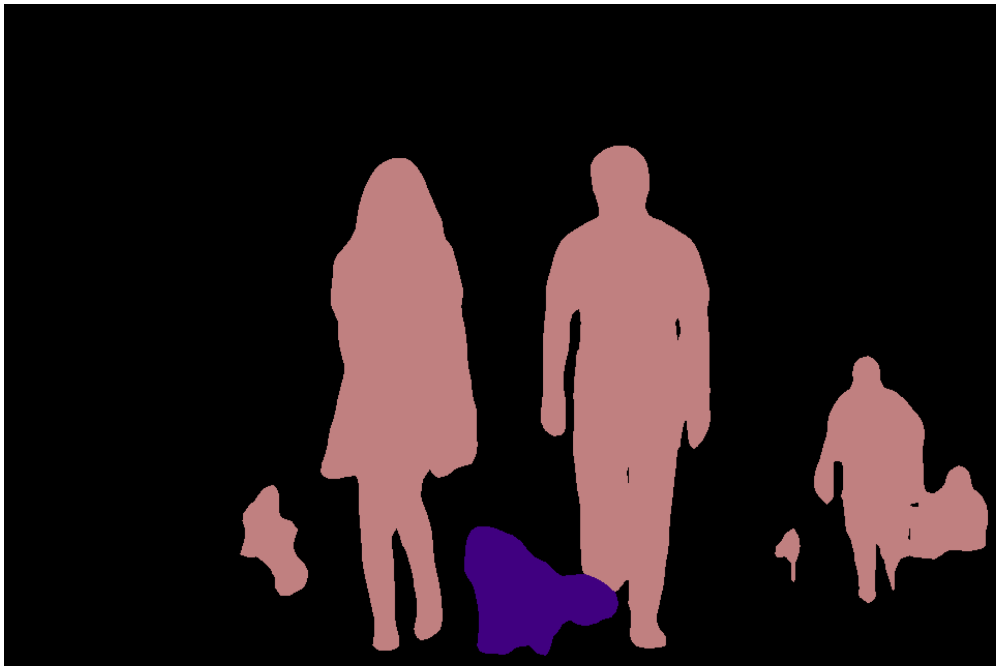

In [ ]:
!wget -nv "https://www.learnopencv.com/wp-content/uploads/2021/01/person-segmentation.jpeg" -O person.png
img = Image.open('./person.png')
plt.imshow(img); plt.show()

print ('Segmenatation Image on FCN')
segment(fcn, path='./person.png', show_orig=False)

print ('Segmenatation Image on DeepLabv3')
segment(dlab, path='./person.png', show_orig=False)

## *Instance Segmentation*



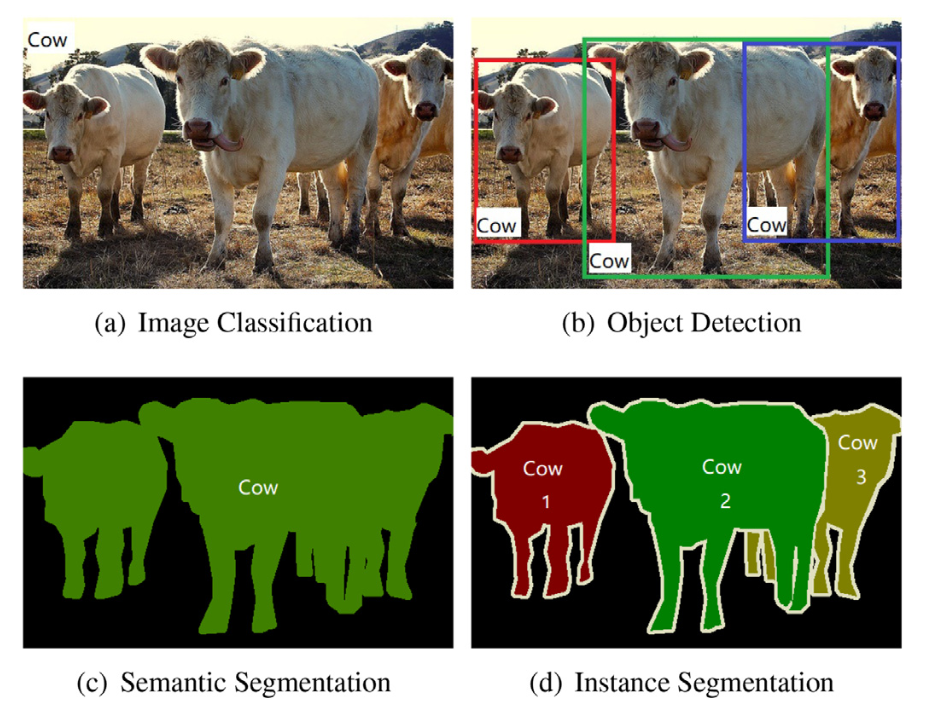



Check this example:

[Mask-RCNN Image Segmentation Demo ](https://colab.research.google.com/github/tensorflow/tpu/blob/master/models/official/mask_rcnn/mask_rcnn_demo.ipynb#scrollTo=DL_0tSC67biu)